# "911, Montgomery County, What's your emergency?"

# Contents:

###  Background
### Set up
### A Little Bit About Montgomery Country, Pennsylvania
### Cleaning our 911 Call Data
 - Loading in from google cloud storage
 - getting the right columns
 - Extracting relevant date/time data from a timestamp
 - Removing calls of strange types that do not happen very often (<10 times)
 - Retrieving Philly's coordinates with Google Geocode API
 - Applying the Haversine function to determine how far each call happened from the centre of philly
 - Analysing these distances with box plot
 - Identifying where those far-away calls originated, and plotting these on a gmap
 - Removing those outlier calls placed more than 1000 km from Philly

### Call Analysis
- Which departments are recieving the most calls?
- Which Type of Traffic calls are the most common?
- When do Vehicle accident calls happen? Which day of the week? Which month of the year?

### Then we have some more hard-hitting investigative analysis questions...
- Is there any link between the # of Events at Philly's famous venue "The Fillmore" and the # of 911 illness calls?
- Could "Subject in Pain" 911 calls be caused by Events at the famous "The Fillmore" concert Venue?
- Could certain Artists Concerts Lead To Increased Shootings?
- Are you more likely to be dehydrated when your further from a reservoir?
- Are you less likely to be bitten from an animal, the further away you are from the zoo?


# Background
We came accross a dataset of 911 calls placed to Montgomery County, Pennsylvania. 

In [1]:
import pandas as pd
# read 911 calls csv
initial_df = pd.read_csv("gs://databucket_for_911/911.csv")
print(f"There were {len(initial_df)} different 911 calls placed in MC between 2015 and 2020")
initial_df.head(2)


There were 663522 different 911 calls placed in MC between 2015 and 2020


,lat,lng,desc,zip,title,timeStamp,twp,addr,e
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1


This dataset contained details of the call including origin Coordinates, timestamp, the department which recieved the call and teh categorisation of the calls.

we decided to investigate and answer the important questions...

# SET UP

#### Ensure no scrolling required on plots

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {return false;}

<IPython.core.display.Javascript object>

#### Setting up pdf to compile all figures in one convenient location

In [3]:
# getting all plots in a single pdf
from matplotlib.backends.backend_pdf import PdfPages
pp = PdfPages('Dans_Part.pdf')

#### Import Libraries/Dependencies

In [4]:


import requests
import json
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import gmaps
from config import gkey
gmaps.configure(api_key = gkey)
from scipy import stats
import seaborn as sns
import mpld3
from mpld3 import plugins
import datetime
import matplotlib.dates as mdates
import folium
from folium import plugins
import warnings
warnings.filterwarnings('ignore')
import IPython
from IPython.display import Image

#### Setting Style with HTML for all Tables including Tooltips

In [5]:
%%HTML
<style type="text/css">
table.dataframe table
{
  border-collapse: collapse;
}
tr:nth-child(even){background-color: #dedede;}
th
{
  color: #ffffff;
  background-color: #000000;
}
table, th
{
  font-family:Arial, Helvetica, sans-serif;
  border: 1px solid black;
  text-align: right;
}
}

#### Testing Style

In [6]:
# Creating random DF to demonstrate table style
df = pd.DataFrame(np.random.randint(0,5,size=(5, 4)), columns=list('ABCD'))
df

,A,B,C,D
0,3,3,1,3
1,0,2,2,2
2,2,4,2,0
3,0,2,3,2
4,0,4,2,4


# A Little bit about Montgomery County, PA 


<img src="https://cdn.theatlantic.com/thumbor/2WTmkoCQeSY_ddsXfNGIKUJsGgY=/0x0:2645x1488/976x549/media/img/mt/2020/11/GettyImages_617806568_16x9/original.jpg"
     alt="Markdown Monster icon"
     style="float: left; margin-right: 10px;" 
     width="800"/>

#### Load in County Statistics CSV

In [7]:
# read County_Stats csv
County_Stats_df = pd.read_csv("CountyStats.csv")
County_Stats_df.head(2)

,State,County,% Adults with Obesity,% Excessive Drinking,Chlamydia Rate,% Drive Alone to Work
0,Alabama,Autauga,33.0,14.0,504.5,86.0
1,Alabama,Baldwin,30.0,19.0,297.2,84.0


#### How many Counties in US?

In [8]:
No_Counties=len(County_Stats_df)
No_Counties

3193

#### Generate County Rankings for each County & Show Results for Montgomery County (MC)

In [9]:
# Create rank columns for the 4 statistics
County_Stats_df['Obesity'] = County_Stats_df['% Adults with Obesity'].rank()
County_Stats_df['Excessive Drinking'] = County_Stats_df['% Excessive Drinking'].rank()
County_Stats_df['Chlamydia'] = County_Stats_df['Chlamydia Rate'].rank()
County_Stats_df['Driving Alone To Work'] = County_Stats_df['% Drive Alone to Work'].rank()

# Narrow down the data frame to only Montgomery County in Pennsylvania
County_Stats_df=County_Stats_df.loc[County_Stats_df["State"]=="Pennsylvania"]
County_Stats_df=County_Stats_df.loc[County_Stats_df["County"]=="Montgomery"]
County_Stats_df.T

# Keep only rank columns
MC_Stats_df=County_Stats_df[["Obesity","Excessive Drinking","Chlamydia","Driving Alone To Work"]]

# Transpose DF and clean for viewing
MC_Stats_df=MC_Stats_df.T
MC_Stats_df["Metric"]=MC_Stats_df.index
MC_Stats_df=MC_Stats_df.rename(columns={2327: "Rank"})
MC_Stats_df=MC_Stats_df.sort_values("Rank", ascending=False)
MC=MC_Stats_df.drop(columns=['Metric'])
MC["Rank"]=MC["Rank"].astype(int)
MC

,Rank
Excessive Drinking,2530
Chlamydia,1228
Driving Alone To Work,879
Obesity,268


#### Fig 1 - How Does Montgomery County Compare to Other US Counties?

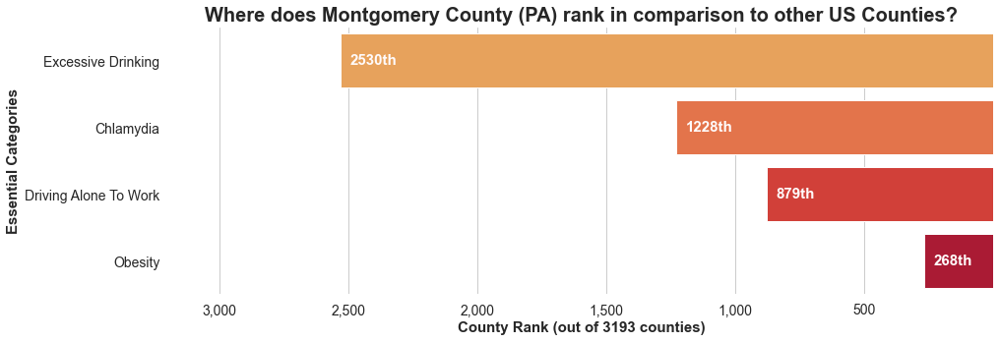

In [10]:
# Set Theme
sns.set_theme(style="whitegrid")
pal = sns.color_palette("YlOrRd", len("Metric"))

# Initialize the figure Layout
fig1, ax1 = plt.subplots(figsize=(15,5))

# Data Manipulation
rank = MC_Stats_df["Rank"].argsort().argsort() 

# Plot
g=sns.barplot(x="Rank", y="Metric", data=MC_Stats_df,label="Rank",palette=np.array(pal[::-1])[rank])

plt.bar_label(g.containers[0],fmt='%ith', label_type='edge', padding=10,color='snow',fontsize=15,fontweight='bold')

# Title
ax1.set_title('Where does Montgomery County (PA) rank in comparison to other US Counties?',
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

# Axes Titles
plt.xlabel(f"County Rank (out of {No_Counties} counties)",size=15,fontweight='bold')
plt.ylabel(f"Essential Categories",size=15,fontweight='bold')


# Ticks
xticks1=ax1.get_xticks()
ax1.set_xticklabels(['{:,.0f}'.format(x)  for x in xticks1],fontdict={'fontsize':14})
plt.yticks(fontsize=14)

# Axes Limits
ax1.set(xlim=(1,No_Counties))

# Final Adjustments
sns.despine(left=True, bottom=True)
ax1.invert_xaxis()

#fig1.tight_layout()
plt.show()
#fig1.savefig('fig1.png')
#pp.savefig(fig1)

# Clean Our 911 Call Data

#### Load in 911 Call csv from Google Cloud Storage

In [11]:
# read 911 calls csv
initial_df = pd.read_csv("gs://databucket_for_911/911.csv")
initial_df.head(2)

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1


In [12]:
# drop useless columns
columns_dropped_1df=initial_df.drop(columns=['desc','twp', 'addr','e'])
columns_dropped_1df.head(2)

,lat,lng,zip,title,timeStamp
0,40.297876,-75.581294,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52
1,40.258061,-75.264680,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21


In [13]:
# Split 'title' into Department and level 2
columns_dropped_1df[['Dept','Type']] = columns_dropped_1df['title'].str.split(': ',expand=True)
# drop the title column
title_split_2df=columns_dropped_1df.drop(columns=['title'])
title_split_2df=title_split_2df.rename(columns={'timeStamp':'TStamp'})
title_split_2df.head(2)

,lat,lng,zip,TStamp,Dept,Type
0,40.297876,-75.581294,19525.0,2015-12-10 17:10:52,EMS,BACK PAINS/INJURY
1,40.258061,-75.264680,19446.0,2015-12-10 17:29:21,EMS,DIABETIC EMERGENCY


In [14]:
# Split timestamp into date and time
title_split_2df[['Date','Time']] = title_split_2df['TStamp'].str.split(' ',expand=True)

# grab the first two characters of the "Time" to have "hour of the day"
title_split_2df["HH"]=title_split_2df["Time"].str[:2]

# use the timestamp to get day of the week, then grab the first 3 characters for a short version
title_split_2df["MMM"]=pd.to_datetime(title_split_2df['TStamp']).dt.month_name().str[:3]
title_split_2df["MM"]=pd.to_datetime(title_split_2df['TStamp']).dt.month

title_split_2df["Date2"]=pd.to_datetime(title_split_2df['TStamp']).dt.strftime('%d/%m/%Y')


# use the date and take the 3 and 4th characters to get Yr
title_split_2df["YY"]=title_split_2df['Date'].str[2:4]


title_split_2df["MMM-YY"] = title_split_2df["MMM"] + "-" +title_split_2df["YY"].astype(str)
title_split_2df["YYMM"] = (title_split_2df["YY"].astype(str) +title_split_2df["MM"].astype(str))


# use the timestamp to get day of the week, then grab the first 3 characters for a short version
title_split_2df["WD"]=pd.to_datetime(title_split_2df['TStamp']).dt.day_name().str[:3]

# use the timestamp to get day of the week by number
title_split_2df["WD#"]=pd.to_datetime(title_split_2df['TStamp']).dt.dayofweek

# Reorder Columns
date_time_fix_3df=title_split_2df[["Dept","Type","YY","MMM","MM","MMM-YY","YYMM","WD","WD#","Date","Date2","HH","Time","TStamp","lat","lng","zip"]]
date_time_fix_3df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0


In [15]:
# Checking how many of each
date_time_fix_3df["Dept"].value_counts()

EMS        332692
Traffic    230208
Fire       100622
Name: Dept, dtype: int64

In [16]:

# Checking how many of each type of call
date_time_fix_3df["Type"].value_counts()

VEHICLE ACCIDENT -     148372
DISABLED VEHICLE -      47909
FIRE ALARM              38452
VEHICLE ACCIDENT        36377
FALL VICTIM             34683
                        ...  
ROAD OBSTRUCTION            2
HIT + RUN                   1
PRISONER IN CUSTODY         1
FOOT PATROL                 1
ANIMAL COMPLAINT            1
Name: Type, Length: 95, dtype: int64

In [17]:

# Remove rows where the category level 2 happens less than 10 times
remove_rare_occurances_4df=date_time_fix_3df
remove_rare_occurances_4df=remove_rare_occurances_4df.groupby('Type').filter(lambda x : len(x)>=10)
remove_rare_occurances_4df["Type"].value_counts()

VEHICLE ACCIDENT -        148372
DISABLED VEHICLE -         47909
FIRE ALARM                 38452
VEHICLE ACCIDENT           36377
FALL VICTIM                34683
                           ...  
DROWNING                      32
TRAIN CRASH                   24
STANDBY FOR ANOTHER CO        22
PLANE CRASH                   11
BOMB DEVICE FOUND             10
Name: Type, Length: 78, dtype: int64

#### Using Google Geocode to retreive Philly's Coordinates

In [18]:
target_city = "Philadelphia, United States"

params = {"address": target_city, "key": gkey}

# Google Maps Geocode url
base_url = "https://maps.googleapis.com/maps/api/geocode/json"

# Run request
response = requests.get(base_url, params=params)

# Convert to JSON
Philly_Geo = response.json()

# Extract lat/lng
Lat_Philly = Philly_Geo["results"][0]["geometry"]["location"]["lat"]
Lon_Philly = Philly_Geo["results"][0]["geometry"]["location"]["lng"]
# Store Values for others
%store Lat_Philly
%store Lon_Philly
# Print results
print(f"{target_city}: {Lat_Philly}, {Lon_Philly}")

Stored 'Lat_Philly' (float)
Stored 'Lon_Philly' (float)
Philadelphia, United States: 39.9525839, -75.1652215


#### Calling in Haversine Function, from another Py File

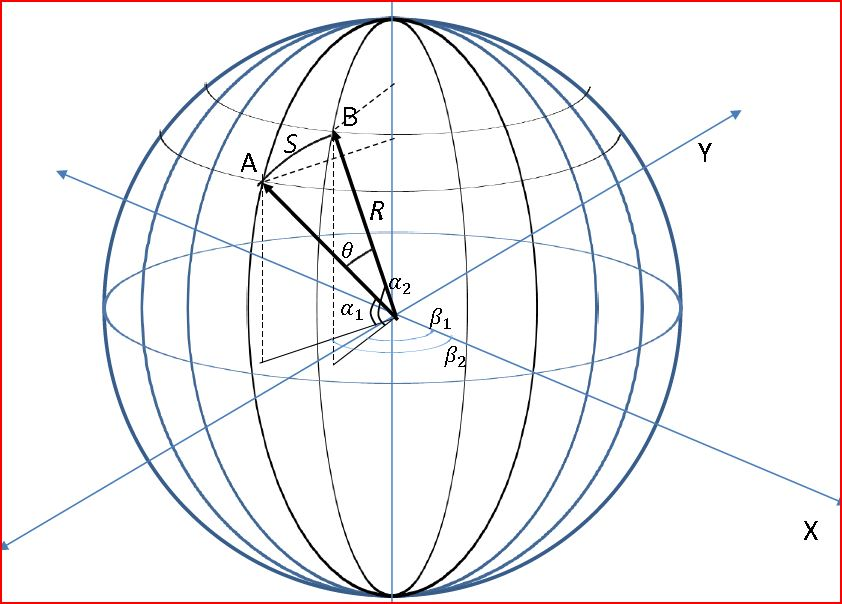

In [19]:
from My_Functions import haversine
?haversine
Image("haversine.jpg")

In [67]:
# Add Distance
from math import radians, cos, sin, asin, sqrt
from My_Functions import haversine
# Read in the philly coorindates variables from another Jupyter Notebook
%store -r Lon_Philly
%store -r Lat_Philly

# new dataframe
distance_to_philly_5df=remove_rare_occurances_4df
distance_to_philly_5df['km from Philly'] = distance_to_philly_5df.apply(lambda row: haversine(
                                            Lon_Philly, 
                                            Lat_Philly, 
                                            row['lng'], 
                                            row['lat']), axis=1)
distance_to_philly_5df.to_csv('distance_from_philly.csv',index=False)
distance_to_philly_5df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0


In [21]:
# read 911 calls csv
#distance_to_philly_5df = pd.read_csv("distance_from_philly.csv")
distance_to_philly_5df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0


In [22]:

# Make distance column into a series for plotting
km_from_Philly = (distance_to_philly_5df['km from Philly'])
km_from_Philly.values

array([52.2, 35. , 24.6, ..., 13.4, 24.6, 13.4])

In [23]:
# We want to calculate some statistics on the distance of the calls

# We create an empty dataframe to store the quartiles and the outliers from the 'km from Philly' column
empty_df = pd.DataFrame(columns=['Low Q','Up Q',"IQR","L Bnd","U Bnd","#O-Liers"])

# We define were we want to take values from
values = distance_to_philly_5df['km from Philly']

# We calculate qurtiles
quartiles = values.quantile([.25,.5,.75])
lowerq = round(quartiles[0.25],2)
upperq = round(quartiles[0.75],2)
iqr = round(upperq - lowerq,2)

lower_bound = round(lowerq - (1.5*iqr),2)
upper_bound = round(upperq + (1.5*iqr),2)
    
outliers_count = (values.loc[(distance_to_philly_5df['km from Philly'] > upper_bound) | (distance_to_philly_5df['km from Philly'] < lower_bound)]).count()
    
data = {
            "Low Q":lowerq,
            "Up Q":upperq,
            "IQR":iqr,
            "L Bnd":lower_bound,
            "U Bnd":upper_bound,
            "#O-Liers":outliers_count}
    
empty_df.loc[1]=data
    
empty_df.T

,1
Low Q,19.3
Up Q,35.8
IQR,16.5
L Bnd,-5.45
U Bnd,60.55
#O-Liers,1337


#### Fig2 

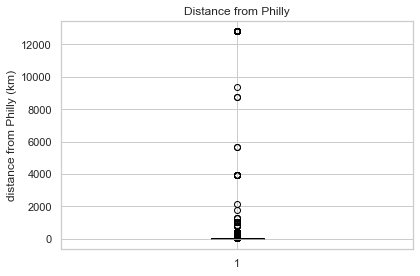

In [24]:

# km_from_Philly = (distance_to_philly_5df['km from Philly']).to_numpy()
km_from_Philly_list = km_from_Philly.values

fig2, ax2 = plt.subplots()
ax2.set_title('Distance from Philly')
ax2.set_ylabel('distance from Philly (km)')
ax2.boxplot(km_from_Philly_list, autorange=True)

plt.tight_layout()
plt.show()

#### Fig3

In [25]:
distance_to_philly_5df['km from Philly'].max()

12798.3

In [73]:
#Use the Lat and Lng as locations
outliers_df = distance_to_philly_5df[distance_to_philly_5df['km from Philly'] > 1000]

locations = outliers_df[["lat","lng"]]



fig3 = gmaps.figure(center = (40.3, -75.6), zoom_level=2)

markers = gmaps.marker_layer(locations)
fig3.add_layer(markers)


fig3

Figure(layout=FigureLayout(height='420px'))

In [27]:
# Drop outliers
Clean_911_df = distance_to_philly_5df[distance_to_philly_5df["km from Philly"] < 1000]
Clean_911_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0


In [28]:
# read Clean 911 calls csv
#Clean_911_df = pd.read_csv("Clean_911.csv")
Clean_911_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0


#### Determine the Date Range for the 911 Call data

In [29]:
# get the min and max date for the sample
min_date=remove_rare_occurances_4df["Date"].min()
min_date_df = remove_rare_occurances_4df[remove_rare_occurances_4df["Date"]==min_date].iloc[0]
min_date_value=f"{min_date_df['MMM']}-{min_date_df['YY']}"

max_date=remove_rare_occurances_4df["Date"].max()
max_date_df = remove_rare_occurances_4df[remove_rare_occurances_4df["Date"]==max_date].iloc[0]
max_date_value=f"{max_date_df['MMM']}-{max_date_df['YY']}"

# Storing these strings for later (to be used in titles of graphs)
%store min_date_value
%store max_date_value

Stored 'min_date_value' (str)
Stored 'max_date_value' (str)


#### Fig4 - # of 911 calls by Department in pie chart¶


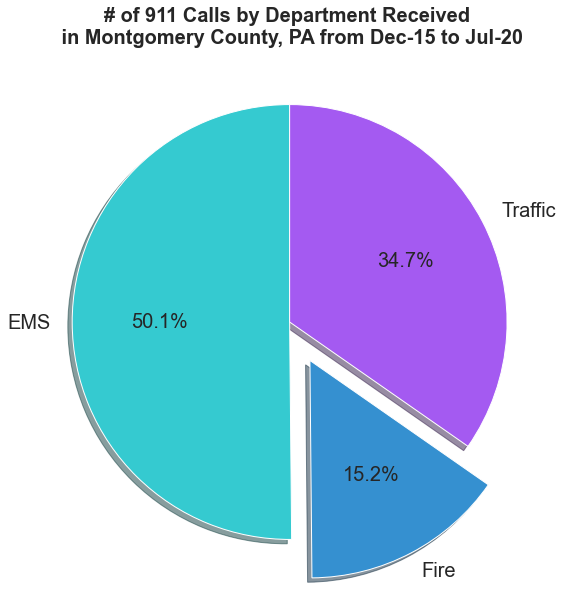

In [30]:
# Initialize the figure Layout
fig4, ax4 = plt.subplots(figsize=(15,10))


Cat1_df= Clean_911_df.groupby(["Dept"]).count().reset_index()
Cat1_df = Cat1_df[["Dept","lat"]]
Cat1_df = Cat1_df.rename(columns={"lat": "Count"})
Cat1_df["Colours"]=["#35CAD0","#3590D0","#A45AF1"]


Cat1_df.plot(kind="pie", 
               y = "Count", 
               autopct='%1.1f%%',
             textprops={'fontsize': 20},
               legend=False,
               startangle=90,
               shadow=True, 
               labels=Cat1_df["Dept"],
               colors = Cat1_df["Colours"],
               explode = (0.0,0.2,0.0),
                ax=ax4)


%store -r min_date_value
%store -r max_date_value
# Title
ax4.set_title(f"# of 911 Calls by Department Received \n in Montgomery County, PA from {min_date_value} to {max_date_value}",
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })




plt.xlabel("")
plt.ylabel("")
plt.show()

#### Fig 5 - 

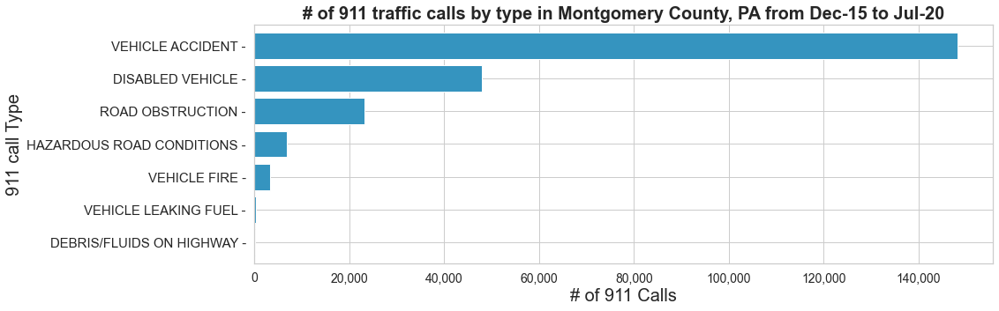

In [31]:
# investigate the different types of traffic 911 calls

# Initialize the figure Layout
Fig5, ax5 = plt.subplots(figsize=(15,5))
#Fig5 =plt.figure(figsize=(10,5))
# create a new dataframe for traffic and see the different categories for traffic calls
# Copy to new df
Traffic_df=Clean_911_df.copy()

# filter for traffic as cat 1
Traffic_df=Traffic_df.loc[Traffic_df["Dept"]=="Traffic"]

traffic_counts = Traffic_df['Type'].value_counts()
y_axis = np.arange(len(traffic_counts))

#Creating Chart

traffic_counts.sort_values(ascending=True).plot(kind="barh", width=0.8, color='#3594BF')

#set chart title
%store -r min_date_value
%store -r max_date_value
# Title
ax5.set_title(f"# of 911 traffic calls by type in Montgomery County, PA from {min_date_value} to {max_date_value}",
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

#plt.title(f"# of 911 traffic calls by type in Montgomery County, PA from {min_date_value} to {max_date_value}")

plt.ylabel("911 call Type", fontsize=20)
plt.xlabel("# of 911 Calls", fontsize=20)

# Ticks
plt.yticks(fontsize=15) 
xticks1=ax5.get_xticks()
ax5.set_xticklabels(['{:,.0f}'.format(x)  for x in xticks1],fontdict={'fontsize':14})
plt.show()

#### Fig 6 - 

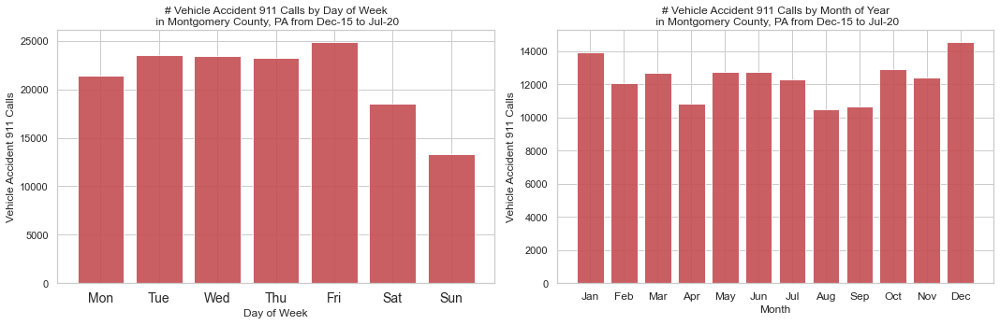

In [32]:
fig6, axes = plt.subplots(1,2,figsize=(15,5))
ax61 = axes[0]
ax62 = axes[1]

# retrieve variables for date range for chart titles
%store -r min_date_value
%store -r max_date_value


# PLOT 1
# Vehicle accident 911 calls by day of the week

# Create a new data frame for vehicle accidents
vehicle_accidents_df=Traffic_df.loc[Traffic_df["Type"]=="VEHICLE ACCIDENT -"]
vehicle_accidents_by_day_df=vehicle_accidents_df.groupby(["WD#"]).count().reset_index()

ax61.bar(vehicle_accidents_by_day_df["WD#"], vehicle_accidents_by_day_df["MM"], color='r', alpha=0.9)
#ax1.set_xticks(vehicle_accidents_by_day_df["WeekDay#"], vehicle_accidents_by_day_df["WeekDay#"], rotation="vertical")

# Set x and y limits
#ax61.set_xlim(-1, len(vehicle_accidents_by_day_df["WD#"]))
#ax61.set_ylim(0, max(vehicle_accidents_by_day_df["MM"])+100)

# Set a Title and labels
ax61.set_title(f"# Vehicle Accident 911 Calls by Day of Week\n in Montgomery County, PA from {min_date_value} to {max_date_value}")
ax61.set_xlabel("Day of Week")
ax61.set_ylabel("Vehicle Accident 911 Calls")


labels3 = [item.get_text() for item in ax61.get_xticklabels()]
labels3[1] = 'Mon'
labels3[2] = 'Tue'
labels3[3] = 'Wed'
labels3[4] = 'Thu'
labels3[5] = 'Fri'
labels3[6] = 'Sat'
labels3[7] = 'Sun'


ax61.set_xticklabels(labels3,fontdict={'fontsize':14})


# PLOT 2
# Vehicle accident 911 calls by Month of the year

# Create a new data frame for vehicle accidents
vehicle_accidents_df=Traffic_df.loc[Traffic_df["Type"]=="VEHICLE ACCIDENT -"]
vehicle_accidents_by_month_df=vehicle_accidents_df.groupby(["MM"]).count().reset_index()

ax62.bar(vehicle_accidents_by_month_df["MM"], vehicle_accidents_by_month_df["lat"], color='r', alpha=0.9)
#ax2.set_xticks(vehicle_accidents_by_month_df["Mth"], vehicle_accidents_by_month_df["Mth"])#, rotation="vertical")


ax62.set_xticks([1,2,3,4,5,6,7,8,9,10,11,12])
#ax62.set_xticks(["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep"])

ax62.set_xticklabels(["Jan","Feb","Mar","Apr","May","Jun","Jul","Aug","Sep","Oct","Nov","Dec"],fontdict={'fontsize':12})

# Set a Title and labels
ax62.set_title(f"# Vehicle Accident 911 Calls by Month of Year\n in Montgomery County, PA from {min_date_value} to {max_date_value}")
ax62.set_xlabel("Month")
ax62.set_ylabel("Vehicle Accident 911 Calls")


fig6.tight_layout()


plt.show()

# Concert Analysis - Do Fillmore concerts cause Illness?
<table>
  <tr>
    <td><img src="https://mavenprodcontent.blob.core.windows.net/media/FillmorePhilly/Assets/venue-info-philly-1.jpg" width=500></td>
    <td><img src="https://c8.alamy.com/comp/2D9XHJ7/drunk-guy-leaning-in-fence-in-front-of-young-people-that-having-fun-in-night-club-with-colorful-laser-lights-2D9XHJ7.jpg" width=500></td>
  </tr>
 </table>

#### Load in Clean 911 Call Data

In [33]:
# read Clean 911 calls csv
#Clean_911_df = pd.read_csv("Clean_911.csv")
Clean_911_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0


#### Filtering for 911 Calls regarding "subject in pain", "Nausea/Vomiting", "Head Injury"

In [34]:
 illness_calls_df=Clean_911_df.copy()

# filter for traffic as cat 1
illness_calls_df=illness_calls_df.loc[(illness_calls_df["Type"]=="NAUSEA/VOMITING")|(illness_calls_df["Type"]=="HEAD INJURY")|(illness_calls_df["Type"]=="SUBJECT IN PAIN")]
# drop useless columns
illness_calls_df=illness_calls_df[['Type','MMM-YY']]
illness_calls_df.head(2)
print(illness_calls_df["Type"].value_counts())
illness_calls_df.head(2)

SUBJECT IN PAIN    19650
HEAD INJURY        18303
NAUSEA/VOMITING     7810
Name: Type, dtype: int64


,Type,MMM-YY
5,HEAD INJURY,Dec-15
6,NAUSEA/VOMITING,Dec-15


#### Group illness calls by month-yr

In [35]:
calls_by_month=illness_calls_df.groupby('MMM-YY').size()
callcount_df=pd.DataFrame({'MMM-YY':calls_by_month.index, 'Illness calls':calls_by_month.values})
callcount_df.head(2)

,MMM-YY,Illness calls
0,Apr-16,772
1,Apr-17,726


#### Load in Historical Concerts at Philly's Filmore Concert Hall CSV

In [36]:
# read County_Stats csv
Fillmore_Events_df = pd.read_csv("Event History at The Fillmore.csv")
Fillmore_Events_df.head(2)

,Date,Concert,Venue,Location
0,"Nov 28, 2015",Andrew McMahon in the Wilderness / New Politic...,The Fillmore Philadelphia,"Philadelphia, Pennsylvania, United States"
1,"Nov 28, 2015",Wilderness Politics Tour,The Fillmore Philadelphia,"Philadelphia, Pennsylvania, United States"


#### Clean Fillmore Event History Data

In [37]:
# drop useless columns
# Create New Date2 Column with matching format to 911 calls date2 column
Fillmore_Events_df["Date2"]=pd.to_datetime(Fillmore_Events_df['Date  '],format="%b %d, %Y ").dt.strftime('%d/%m/%Y')
Fillmore_Events_df["YY"]=pd.DatetimeIndex(Fillmore_Events_df['Date  ']).year.astype(str).str[2:4]
#Fillmore_Events_df["MM"]=pd.DatetimeIndex(Fillmore_Events_df['Date  ']).month.astype(str)
Fillmore_Events_df["MMM"]=pd.to_datetime(Fillmore_Events_df['Date  ']).dt.month_name().str[:3]
Fillmore_Events_df["MMM-YY"]= Fillmore_Events_df["MMM"] + "-" +Fillmore_Events_df["YY"].astype(str)
#Fillmore_Events_df["YYMM"] = Fillmore_Events_df["YY"].astype(str) +Fillmore_Events_df["MM"].astype(str)
Fillmore_Events_df=Fillmore_Events_df.drop(columns=['Venue  ','Location  ','YY','MMM','Date  '])

Fillmore_Events_df.head(2)

,Concert,Date2,MMM-YY
0,Andrew McMahon in the Wilderness / New Politic...,28/11/2015,Nov-15
1,Wilderness Politics Tour,28/11/2015,Nov-15


#### Group Fillmore Events by Year-Month

In [38]:
events_by_month=Fillmore_Events_df.groupby('MMM-YY').size()
eventcount_df=pd.DataFrame({'MMM-YY':events_by_month.index, 'Events':events_by_month.values})
eventcount_df.head(2)

,MMM-YY,Events
0,Apr-20,1
1,Dec-16,11


#### Merge Monthly Events with Monthly Illness Calls on the Column=Month

In [39]:
monthly_df=callcount_df.merge(eventcount_df, left_on='MMM-YY', right_on='MMM-YY', how='inner')
monthly_df.head(2)

,MMM-YY,Illness calls,Events
0,Apr-20,617,1
1,Dec-16,770,11


#### Perform Linear Regression on Monthly Events Vs Monthly Calls 

In [40]:
Call_Count=monthly_df.iloc[:,1].astype(float)
Events_Count=monthly_df.iloc[:,2].astype(float)
slope1, int1, r1, p, std_err = stats.linregress(Events_Count, Call_Count)
Predicted1 = Events_Count * slope1 + int1
line_eq1 = "y =" + str(round(slope1,2)) + "x + " + str(round(int1,2))
print(line_eq1)
print(f"r={round(r1,3)}")

y =3.2x + 804.9
r=0.265


#### Setting labels for the tooltip in the graph

In [41]:
labels = []
for i in range(len(monthly_df)):
    label = monthly_df.iloc[[i], :].T
    label=label.rename(index={'MMM-YY': ' '})
    new_header = label.iloc[0] #grab the first row for the header
    label = label[1:] #take the data less the header row
    label.columns = new_header #set the header row as the df header
    #label.drop(label.tail(1).index,inplace=True) # drop last n rows
    labels.append(str(label.to_html()))
label

,Oct-19
Illness calls,896
Events,8


#### Fig7 - # of Monthly Illness Calls against # of Monthly Events

In [42]:
# Initialize the figure Layout
fig7, ax7 = plt.subplots(figsize=(10, 6),subplot_kw=dict(facecolor='#ffffff'))

# Set Theme
sns.set_theme(style="whitegrid")
ax7.grid(True, alpha=0.2)

# Plot
points = ax7.plot(monthly_df["Events"], monthly_df["Illness calls"], 'o', color='b', mec='k', ms=15, mew=3, alpha=.6)

# Title
ax7.set_title(f"Illness 911 Calls per Month Vs. Fillmore Events per Month",
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

# Axes Titles
plt.xlabel(f"Fillmore Events Per Month", fontsize="15")
plt.ylabel(f"Illness Calls Per Month", fontsize="15")

# Plot Linear Regression
plt.plot(Events_Count,Predicted1, "g",linewidth=5)
plt.annotate(line_eq1,(1.5,760),fontsize=25,color="green")
plt.annotate(f"r = {round(r1,2)}",(1.5,720),fontsize=25,color="green")

# Tooltips
tooltip = mpld3.plugins.PointHTMLTooltip(points[0], labels, voffset=10, hoffset=10)
mpld3.plugins.connect(fig7, tooltip)

#fig2.tight_layout()
#pp.savefig(fig2)
#fig2.savefig('fig2.png')
print("Each dot represents a different Year-Month")
mpld3.display()
#plt.show()

Each dot represents a different Year-Month


# Concert Analysis - Do certain Artists Concerts Lead To Increased Shootings?

#### Filter only Shooting-related 911 calls

In [43]:
Shootings_df=Clean_911_df.copy()
Shootings_df=Shootings_df.loc[Shootings_df["Type"]=="SHOOTING"]
Shootings_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly
1241,EMS,SHOOTING,15,Dec,12,Dec-15,1512,Mon,0,2015-12-14,14/12/2015,02,02:41:29,2015-12-14 02:41:29,40.120019,-75.347817,19401.0,24.3
2051,EMS,SHOOTING,15,Dec,12,Dec-15,1512,Tue,1,2015-12-15,15/12/2015,21,21:31:34,2015-12-15 21:31:34,40.125663,-75.333716,19401.0,24.0


#### Group Shootings Calls by Year-Month

In [44]:
Shootings_by_Month=Shootings_df.groupby('YYMM').size()
shootingscount_df=pd.DataFrame({'YYMM':Shootings_by_Month.index, 'Shootings':Shootings_by_Month.values})
shootingscount_df.head(2)

,YYMM,Shootings
0,1512,3
1,161,5


#### Convert Shootings to Time Series and Generate Moving Average

In [48]:



shootingscount_df["year"]="20"+shootingscount_df["YYMM"].astype(str).str[:2]
shootingscount_df["month"]=shootingscount_df["YYMM"].astype(str).str[2:4]
shootingscount_df['date'] = shootingscount_df['month'].map(str)+ '-' +shootingscount_df['year'].map(str)
shootingscount_df['date'] = pd.to_datetime(shootingscount_df['date'], format='%m-%Y').dt.strftime('%m-%Y')



shootingscount_df['date'] = pd.to_datetime(shootingscount_df['date'])
df1 = shootingscount_df.groupby(shootingscount_df['date'].dt.to_period('M')).sum()
df1 = df1.resample('M').asfreq().fillna(0)
#df1=df1.drop(columns=['YYMM'])


df1
df1["Date"]=df1.index
df1['Moving_Average'] = df1["Shootings"].rolling(window=6).mean()
df1.head(2)

,Shootings,Date,Moving_Average
date,,,
2015-12,3.0,2015-12,NaN
2016-01,5.0,2016-01,NaN


#### When was the "Cypress Hill" Concert?

In [49]:
mask = np.column_stack([Fillmore_Events_df["Concert  "].str.contains("Cypress Hill", na=True) for col in Fillmore_Events_df])
Cypress_Hill_concert_Date=Fillmore_Events_df.loc[mask.any(axis=1)].Date2
print(Cypress_Hill_concert_Date)

11    28/10/2015
Name: Date2, dtype: object


#### When was the "Murda Beatz" Concert?

In [50]:
mask = np.column_stack([Fillmore_Events_df["Concert  "].str.contains("Murda Beatz", na=True) for col in Fillmore_Events_df])
Murda_Beatz_concert_Date=Fillmore_Events_df.loc[mask.any(axis=1)].Date2
print(Murda_Beatz_concert_Date)

132    12/12/2019
Name: Date2, dtype: object


#### Fig8 - Did These concerts appear to have any lasting effect on the number of shootings in subsequent months?

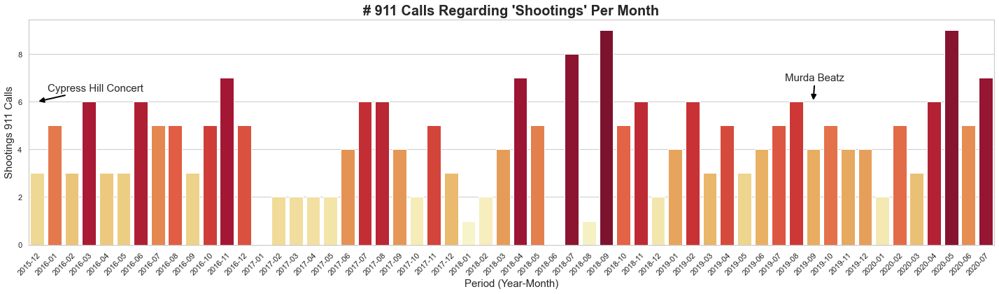

In [51]:
# Initialize the figure Layout
fig8, ax8 = plt.subplots(figsize=(20, 6))

# Set sns Theme
sns.set_theme(style="whitegrid")
pal = sns.color_palette("YlOrRd", len(df1["Date"]))

# Data Manipulation
Rank = -df1["Shootings"].argsort().argsort()
df2  = df1.set_index('Date')
df2=df2[["Moving_Average"]]
df2
df2.columns.name = df2.index.name
df2.index.name = None
df2=df2.dropna()
df2.head(2)

# Plot
ax8 = sns.barplot(x="Date", y="Shootings", data=df1,palette=np.array(pal[::-1])[Rank])

# Title
ax8.set_title("# 911 Calls Regarding 'Shootings' Per Month",
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

# Axes Titles
plt.xlabel("Period (Year-Month)",size=15)
plt.ylabel("Shootings 911 Calls",size=15)

# Ticks
ax8.set_xticklabels(ax8.get_xticklabels(),rotation=45,ha="right",rotation_mode='anchor')

# Annotations
plt.annotate('Cypress Hill Concert', xy=(0, 6), xytext=(15, 15),fontsize=15, textcoords='offset points', arrowprops=dict(arrowstyle='-|>',color='black',lw=2,ls='-'))
plt.annotate('Murda Beatz', (45, 6), xytext=(-40, 30), fontsize=15,textcoords='offset points', arrowprops=dict(arrowstyle='-|>',color='black',lw=2,ls='-'))


#df2.plot()
fig8.tight_layout()
plt.show()
#fig3.savefig('fig3.png')
#pp.savefig(fig3)

# Are you more likely to become dehydrated if your further from a reservoir?

#### What is the largest Reservoir in Montgomery County? (Google Maps Text Search), Retrieve Coordinates

In [52]:
my_phrase = "largest reservoir in montgomery county pa"

params = {"query": my_phrase,"key": gkey}

# Google Maps Text Search url
target_url = "https://maps.googleapis.com/maps/api/place/textsearch/json"

# Run request and convert to JSON
response = requests.get(target_url, params).json()
print(response["results"][0]["name"])
print(response["results"][0]["formatted_address"])

# Extract lat/lng 
Lat_Reservoir=response["results"][0]["geometry"]["location"]["lat"]
Lon_Reservoir=response["results"][0]["geometry"]["location"]["lng"]

Green Lane Reservoir
Green Lane Reservoir, Pennsylvania, USA


#### How far away was each 911 call from Green Lane Reservoir? Using Haversine Function to Add Km from Reservoir Column

In [53]:
# new dataframe
Distances_df=Clean_911_df.copy()

# Add Distance
Distances_df['km from Reservoir'] = Distances_df.apply(lambda row: haversine(
                                            Lon_Reservoir, 
                                            Lat_Reservoir, 
                                            row['lng'], 
                                            row['lat']), axis=1)
Distances_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly,km from Reservoir
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2,10.9
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0,23.9


#### Adding Bins of how far each call was from the Reservoir. Using QCUT to get equally sized bins for all 911 calls

In [54]:
no_of_bins=20
# creating empty list of the right dimensions
labels1 = [None] * (no_of_bins)

# QCUT All the calls into equal sized bins
cut_series, cut_intervals=pd.qcut(Distances_df['km from Reservoir'], q=no_of_bins,labels=False,retbins=True)

# get the list of bins to get the labels
for i in range(len(cut_intervals)-1):
    labels1[i]=f"{int(cut_intervals[i])} - {int(cut_intervals[i+1])}"

# use CUT to create a column of which bin each call falss in    
Distances_df['km from Reservoir bin'] = pd.cut(Distances_df['km from Reservoir'], bins=cut_intervals, labels=labels1)

Distances_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,Date2,HH,Time,TStamp,lat,lng,zip,km from Philly,km from Reservoir,km from Reservoir bin
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2,10.9,0 - 12
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,10/12/2015,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0,23.9,22 - 24


#### Fig9 - Plot the Bins for all 911 calls in a histogram to show the Equality of bins derived from QCUT

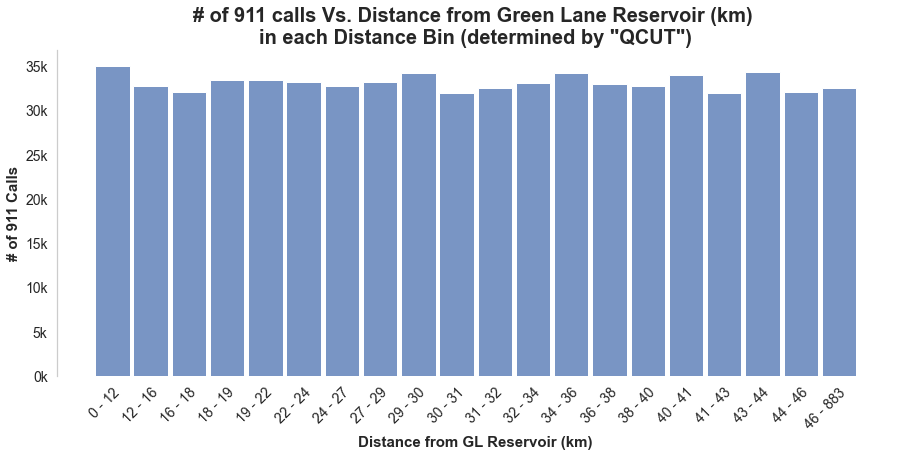

In [55]:
# Initialize the figure Layout
fig9, ax9 = plt.subplots(figsize=(15, 6))

# Set Theme
sns.set_theme(style="whitegrid")
ax9.grid(False)

# Plot
ax9=sns.histplot(Distances_df, x="km from Reservoir bin",shrink=0.9, discrete=True,fill=True)

# Title
ax9.set_title('# of 911 calls Vs. Distance from Green Lane Reservoir (km) \nin each Distance Bin (determined by "QCUT")',
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

# Axes Titles
plt.xlabel(f"Distance from GL Reservoir (km)",size=15,fontweight='bold')
plt.ylabel(f"# of 911 Calls",size=15,fontweight='bold')

# Ticks
ax9.set_xticklabels(labels1,rotation=45,ha="right",rotation_mode='anchor',fontdict={'fontsize':14})
yticks=ax9.get_yticks()
ax9.set_yticklabels(['{:,.0f}k'.format(x/1000)  for x in yticks],fontdict={'fontsize':14})

# Final Adjustments
sns.despine(left=False, bottom=True)

plt.show()

#### Fig10 - Using the same bins (which were equally weighted for "all" 911 calls), Demonstrate whether a relatively larger proportion of "Dehydration" type calls were encountered further from the reservoir, as opposed to those near the reservoir

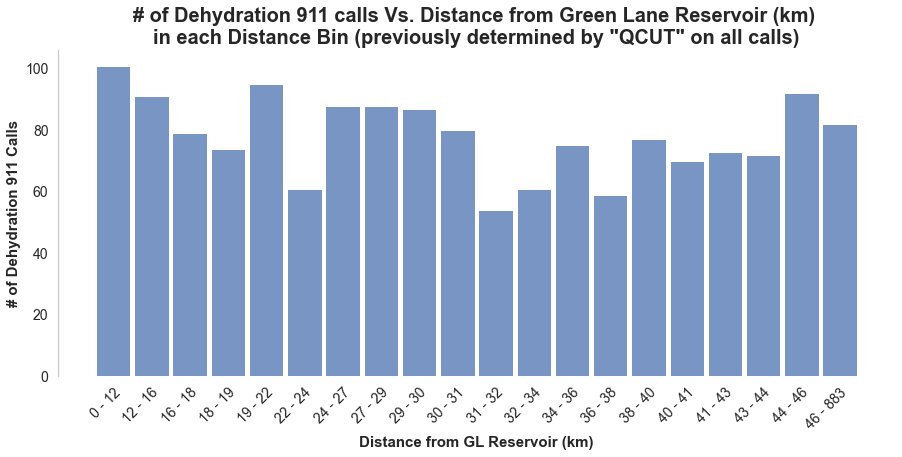

In [56]:
# Initialize the figure Layout
fig10, ax10 = plt.subplots(figsize=(15, 6))

# Set sns Theme
sns.set_theme(style="whitegrid")
ax10.grid(False)

# Data Manipulation
Dehydration_df=Distances_df.loc[Distances_df["Type"]=="DEHYDRATION"]

# Plot
ax10=sns.histplot(Dehydration_df, x="km from Reservoir bin",shrink=0.9, discrete=True,fill=True)

# Title
ax10.set_title('# of Dehydration 911 calls Vs. Distance from Green Lane Reservoir (km) \nin each Distance Bin (previously determined by "QCUT" on all calls)',
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

# Axes Titles
plt.xlabel(f"Distance from GL Reservoir (km)",size=15,fontweight='bold')
plt.ylabel(f"# of Dehydration 911 Calls",size=15,fontweight='bold')

# Ticks
ax10.set_xticklabels(labels1,rotation=45,ha="right",rotation_mode='anchor',fontdict={'fontsize':14})
yticks2=ax10.get_yticks()
ax10.set_yticklabels(['{:,.0f}'.format(x)  for x in yticks2],fontdict={'fontsize':14})

# Final Adjustments
sns.despine(left=False, bottom=True)

plt.show()

#### Fig11 - 

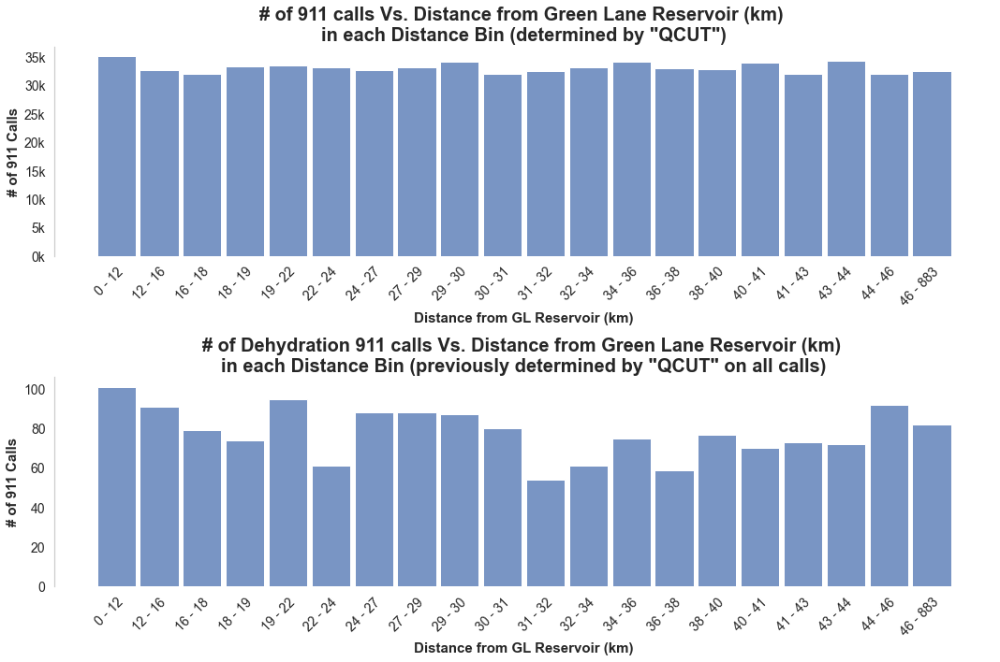

In [57]:
# Initialize the figure Layout
fig11, axes = plt.subplots(2,figsize=(15,10))
ax111 = axes[0]
ax112 = axes[1]

# Set sns Theme
sns.set_theme(style="whitegrid")
axes[0].grid(False)

# Plot
axes[0]=sns.histplot(Distances_df,ax=axes[0], x="km from Reservoir bin",shrink=0.9, discrete=True,fill=True)

# Title
axes[0].set_title('# of 911 calls Vs. Distance from Green Lane Reservoir (km) \nin each Distance Bin (determined by "QCUT")',
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

# Axes Titles
axes[0].set_xlabel(f"Distance from GL Reservoir (km)",size=15,fontweight='bold')
axes[0].set_ylabel(f"# of 911 Calls",size=15,fontweight='bold')

# Ticks
axes[0].set_xticklabels(labels1,rotation=45,ha="right",rotation_mode='anchor',fontdict={'fontsize':14})
yticks=ax111.get_yticks()
axes[0].set_yticklabels(['{:,.0f}k'.format(x/1000)  for x in yticks],fontdict={'fontsize':14})

#sns.despine(left=False, bottom=True)


# Data Manipulation
Dehydration_df=Distances_df.loc[Distances_df["Type"]=="DEHYDRATION"]

ax112.grid(False)

# Plot
ax112=sns.histplot(Dehydration_df, x="km from Reservoir bin",shrink=0.9, discrete=True,fill=True)

# Title
ax112.set_title('# of Dehydration 911 calls Vs. Distance from Green Lane Reservoir (km) \nin each Distance Bin (previously determined by "QCUT" on all calls)',
             fontdict ={
                 'fontsize': 20,
                 'fontweight' : 'bold'
                         })

# Axes Titles
ax112.set_xlabel(f"Distance from GL Reservoir (km)",size=15,fontweight='bold')
ax112.set_ylabel(f"# of 911 Calls",size=15,fontweight='bold')

# Ticks
ax112.set_xticklabels(labels1,rotation=45,ha="right",rotation_mode='anchor',fontdict={'fontsize':14})
yticks2=ax112.get_yticks()
ax112.set_yticklabels(['{:,.0f}'.format(x)  for x in yticks2],fontdict={'fontsize':14})

# Final Adjustments
sns.despine(left=False, bottom=True)

# ensure the plots dont overlap
fig11.tight_layout()

plt.show()

# ANIMAL BITES 911 CALLS

In [59]:
import IPython
IPython.display.Audio("a3b0b9ad-2dd5-4b47-b2dc-8fd4c7961f77-[AudioTrimmer.com].mp3",autoplay=False)

<img src="https://dmn-dallas-news-prod.cdn.arcpublishing.com/resizer/qhbnP-EYqtwlC0B2hp-f_kAfvcI=/1660x934/smart/filters:no_upscale()/arc-anglerfish-arc2-prod-dmn.s3.amazonaws.com/public/FLXKXLHRGVB5PDB5DFIPT6NDQI.JPG"
     alt="Markdown Monster icon"
     style="float: left; margin-right: 10px;" />

#### Retrieve the coordinates of Montgomery County's nearest Zoo via Google Maps Text Search

In [60]:
my_phrase = "zoo in montgomery county pa"

params = {"query": my_phrase,"key": gkey}

# Google Maps Text Search url
target_url = "https://maps.googleapis.com/maps/api/place/textsearch/json"

# Run request and convert to JSON
response = requests.get(target_url, params).json()
print(response["results"][0]["name"])
print(response["results"][0]["formatted_address"])

# Extract lat/lng 
Lat_Zoo=response["results"][0]["geometry"]["location"]["lat"]
Lon_Zoo=response["results"][0]["geometry"]["location"]["lng"]

Elmwood Park Zoo
1661 Harding Blvd, Norristown, PA 19401, United States


#### How far away was each 911 call from Elmwood Park Zoo? Using Haversine Function to Add Km from Zoo Column

In [61]:
# Add Distance from Zoo column
Distances_df['km from Zoo'] = Distances_df.apply(lambda row: haversine(
                                            Lon_Zoo, 
                                            Lat_Zoo, 
                                            row['lng'], 
                                            row['lat']), axis=1)
Distances_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,...,HH,Time,TStamp,lat,lng,zip,km from Philly,km from Reservoir,km from Reservoir bin,km from Zoo
0,EMS,BACK PAINS/INJURY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,...,17,17:10:52,2015-12-10 17:10:52,40.297876,-75.581294,19525.0,52.2,10.9,0 - 12,27.6
1,EMS,DIABETIC EMERGENCY,15,Dec,12,Dec-15,1512,Thu,3,2015-12-10,...,17,17:29:21,2015-12-10 17:29:21,40.258061,-75.264680,19446.0,35.0,23.9,22 - 24,15.2


#### Filter only Animal Bite-related 911 calls

In [62]:
Bites_df=Distances_df.loc[Distances_df["Type"]=="ANIMAL BITE"]
Bites_df.head(2)

,Dept,Type,YY,MMM,MM,MMM-YY,YYMM,WD,WD#,Date,...,HH,Time,TStamp,lat,lng,zip,km from Philly,km from Reservoir,km from Reservoir bin,km from Zoo
2871,EMS,ANIMAL BITE,15,Dec,12,Dec-15,1512,Fri,4,2015-12-18,...,08,08:43:19,2015-12-18 08:43:19,40.124162,-75.363580,19403.0,25.5,30.2,29 - 30,2.4
3743,EMS,ANIMAL BITE,15,Dec,12,Dec-15,1512,Mon,0,2015-12-21,...,00,00:30:30,2015-12-21 00:30:30,40.068392,-75.318553,19428.0,18.3,37.4,36 - 38,7.4


In [63]:
# set base map up
Bite_Map=folium.Map(location=[40.2,-75.5],control_scale=True,zoom_start = 10,tiles = "Stamen Toner")

# Add 5/10 km radius circles around the Zoo
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=5000,popup="5km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=10000,popup="10km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=15000,popup="15km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=20000,popup="20km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=25000,popup="25km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=30000,popup="30km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=35000,popup="35km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=40000,popup="40km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=45000,popup="45km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=50000,popup="50km",color='blue',opacity=0.2).add_to(Bite_Map)


# add the most animal looking icon to represent the zoo which happens to be the linux one
folium.Marker([Lat_Zoo,Lon_Zoo], 
              icon=folium.Icon(color="red",icon="linux", prefix='fa') 
             ).add_to(Bite_Map)

# Map with time
Bites_df['MMM-YY'] = Bites_df['MMM-YY'].sort_values(ascending=True)
data = []
for _, d in Bites_df.groupby('MMM-YY'):
    data.append([[row['lat'], row['lng']] for _, row in d.iterrows()])
hm = folium.plugins.HeatMapWithTime(data, auto_play=True,
                             display_index=False,
                             gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'},
                             min_speed=5, 
                             #index=Bites_df.groupby(['MMM-YY']).size(),
                             max_opacity=0.5,
                            radius=50)

# Title
title_html = '''
             <h3 align="center" style="font-size:16px"><b>Animal Bite 911 Calls within a 50km radius of Philly Zoo, Cycling through the Year-Month Periods from 2015 - 2020</b></h3>
             ''' 

Bite_Map.get_root().html.add_child(folium.Element(title_html))

hm.add_to(Bite_Map)

Bite_Map

In [64]:
# set base map up
Bite_Map=folium.Map(location=[40.2,-75.5],control_scale=True,zoom_start = 10,tiles = "Stamen Toner")

# Add 5/10 km radius circles around the Zoo
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=5000,popup="5km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=10000,popup="10km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=15000,popup="15km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=20000,popup="20km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=25000,popup="25km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=30000,popup="30km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=35000,popup="35km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=40000,popup="40km",color='blue',opacity=0.2).add_to(Bite_Map)
#folium.Circle([Lat_Zoo, Lon_Zoo],radius=45000,popup="45km",color='red',opacity=0.2).add_to(Bite_Map)
folium.Circle([Lat_Zoo, Lon_Zoo],radius=50000,popup="50km",color='blue',opacity=0.2).add_to(Bite_Map)


# add the most animal looking icon to represent the zoo which happens to be the linux one
folium.Marker([Lat_Zoo,Lon_Zoo], 
              icon=folium.Icon(color="red",icon="linux", prefix='fa') 
             ).add_to(Bite_Map)

# Map with time
Distances_df['MMM-YY'] = Distances_df['MMM-YY'].sort_values(ascending=True)
data = []

for _, d in Distances_df.groupby('MMM-YY'):
    data.append([[row['lat'], row['lng']] for _, row in d.iterrows()])
hm = folium.plugins.HeatMapWithTime(data, auto_play=True,
                             display_index=False,
                             gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'},
                             min_speed=5, 
                             #index=Bites_df.groupby(['MMM-YY']).size(),
                             max_opacity=0.5,
                            radius=50)

# Title
title_html = '''
             <h3 align="center" style="font-size:16px"><b>All 911 Calls within a 50km radius of Philly Zoo, Cycling through the Year-Month Periods from 2015 - 2020</b></h3>
             ''' 
Bite_Map.get_root().html.add_child(folium.Element(title_html))

hm.add_to(Bite_Map)
Bite_Map